In [134]:
import numpy as np
import matplotlib.pyplot as plt

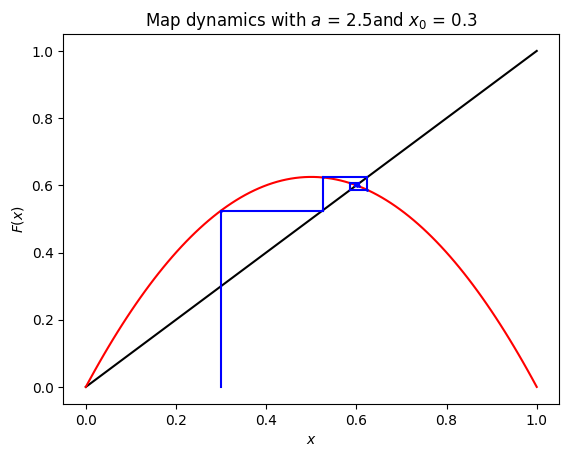

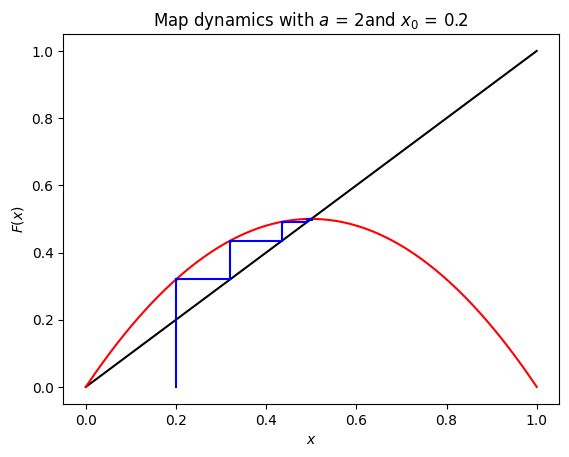

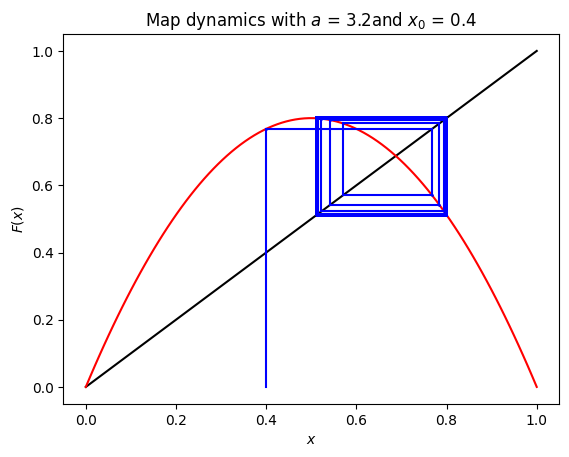

In [135]:

# Parameters
a = 2.5
x_0 = 0.3
N = 500

# logistic map function
def F(x, a):
    return a*x*(1-x)

# Simulate the map
def single_simulation(x_0, N, a):
    x = np.zeros(N)
    x[0] = x_0
    for i in range(1,N):
        x[i] = F(x[i-1], a)
    return x

# Plotting the map, as well as the identity line and function F
def plot_map(x_sim):
    x = np.linspace(0,1,100)
    plt.plot(x, x, 'k', markersize=1)
    plt.plot(x, F(x, a), 'r', markersize=1)
    plt.plot(x_sim[:-1], x_sim[1:], 'bo', markersize=1)
    plt.plot([x_sim[0],x_sim[0]], [0, x_sim[0]], 'b', markersize=1)
    for i in range(len(x_sim)-1):
        plt.plot([x_sim[i], x_sim[i]], [x_sim[i], x_sim[i+1]], 'b', markersize=1)
        plt.plot([x_sim[i], x_sim[i+1]], [x_sim[i+1], x_sim[i+1]], 'b', markersize=1)
    plt.xlabel(r'$x$')
    plt.ylabel(r'$F(x)$')
    plt.title(r'Map dynamics with $a$ = ' + str(a) + 'and $x_0$ = ' + str(x_0))
    plt.show()

plot_map(single_simulation(x_0, N, a))
a, x_0 = 2, 0.2
plot_map(single_simulation(x_0, N, a))
a, x_0 = 3.2, 0.4
plot_map(single_simulation(x_0, N, a))

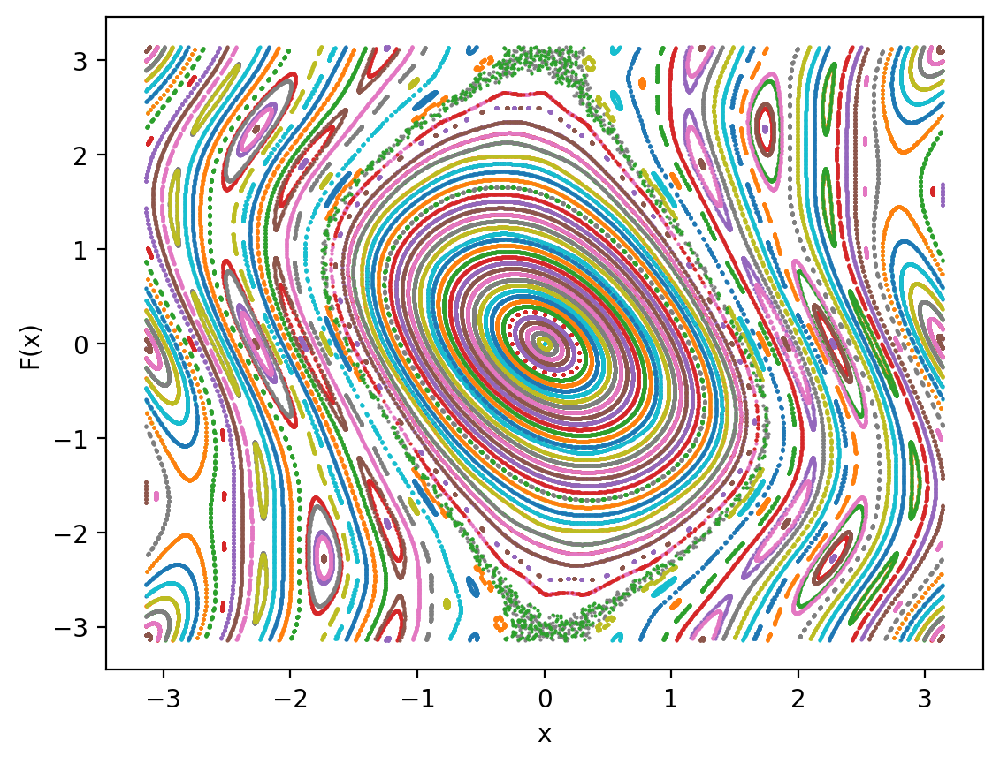

In [136]:
# Redefining F
def F(x, y, a):
    return x+a*np.sin(x+y), x + y

# Modifying single_simulation to accomodate 2 variables
def single_simulation(x_0, y_0, N, a):
    x = np.zeros(N)
    y = np.zeros(N)
    x[0], y[0] = x_0, y_0
    for i in range(1,N):
        x[i], y[i] = F(x[i-1], y[i-1], a)
    return x, y

def NP_simulation(NP, N, a):
    x_init = np.linspace(0,2*np.pi,NP)
    x = np.zeros(NP*N)
    y = np.zeros(NP*N)
    for j in range(NP):
        x[j*N:(j+1)*N], y[j*N:(j+1)*N] = single_simulation(x_init[j], 0, N, a)
    # normalizing x and y between -pi and pi
    x = np.mod(x, 2*np.pi)
    y = np.mod(y, 2*np.pi)
    x = x - 2*np.pi*(x>np.pi)
    y = y - 2*np.pi*(y>np.pi)
    return x,y

def plot_NP_simulation(NP, N, a):
    x, y = NP_simulation(NP, N, a)
    for i in range(NP):
        plt.plot(x[i*N:(i+1)*N], y[i*N:(i+1)*N], '.', markersize=1)
    plt.xlabel('x')
    plt.ylabel('F(x)')
    plt.gcf().set_dpi(200)
    plt.show()

N = 800
a = -0.7
plot_NP_simulation(150, N, a)

3-periodic orbit


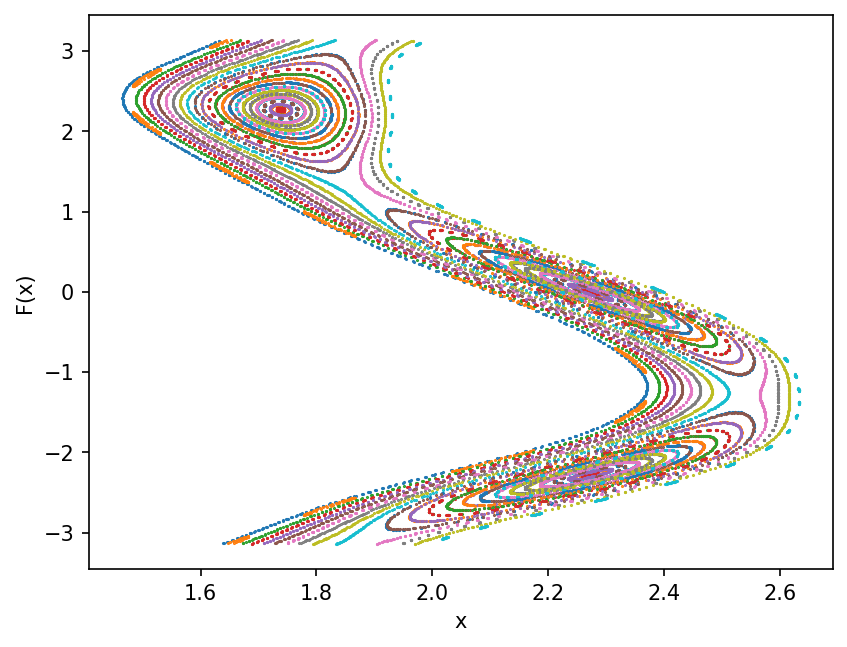

In [137]:
# Now modifying the code to zoom in on the plot
def NP_magnify_simulation(NP, N, a, start, end):
    x_init = np.linspace(start, end, NP)
    x = np.zeros(NP*N)
    y = np.zeros(NP*N)
    for j in range(NP):
        x[j*N:(j+1)*N], y[j*N:(j+1)*N] = single_simulation(x_init[j], 0, N, a)
    x = np.mod(x, 2*np.pi)
    y = np.mod(y, 2*np.pi)
    # normalize x and y between -pi and pi
    x = x - 2*np.pi*(x>np.pi)
    y = y - 2*np.pi*(y>np.pi)
    return x,y

def plot_NP_magnify_simulation(NP, N, a, start, end, magnify=True):
    x, y = NP_magnify_simulation(NP, N, a, start, end)
    for i in range(NP):
        plt.plot(x[i*N:(i+1)*N], y[i*N:(i+1)*N], '.', markersize=1)
    if not magnify:
        # show the plot from -pi to pi
        plt.xlim(-np.pi, np.pi)
        plt.ylim(-np.pi, np.pi)
    plt.xlabel('x')
    plt.ylabel('F(x)')
    plt.gcf().set_dpi(150)
    plt.show()

N = 500
a = -0.7
start, end = 2.1, 2.4
print("3-periodic orbit")
plot_NP_magnify_simulation(40, N, a, start, end)


4-periodic orbit


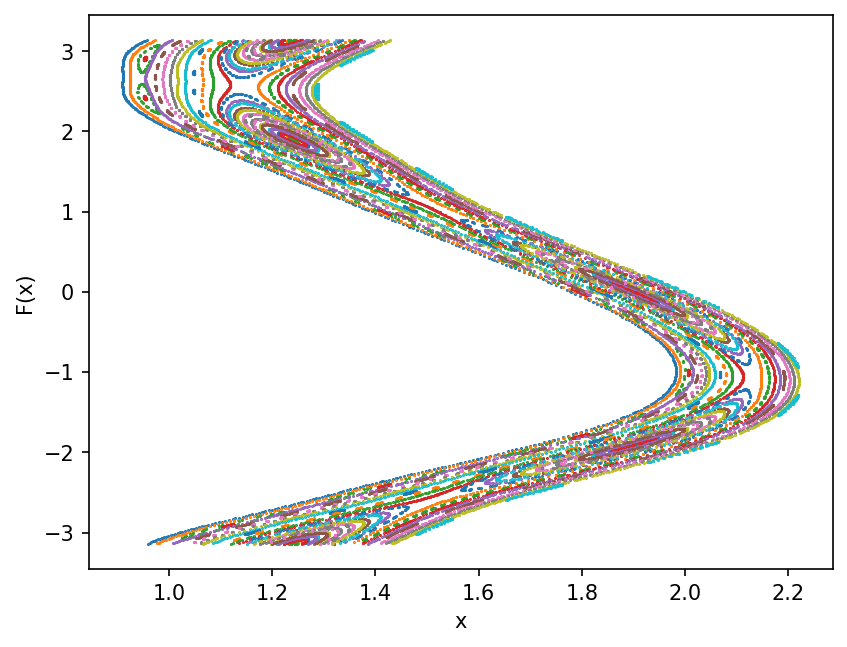

In [138]:
start, end = 1.78, 2
print("4-periodic orbit")
plot_NP_magnify_simulation(40, N, a, start, end)

In [139]:
#from scipy.optimize import newton_krylov
import scipy.optimize as opt
# Now using the Newton-Krylov method to find the fixed point.
# The Newton-Krylov method is a generalization of Newton's method
# It is a more efficient method for solving systems of nonlinear equations

# Redefining F to be able to use fsolve
def norm_F(p, a):
    x, y = p
    x, y = x+a*np.sin(x+y), x + y

    # Normalizing between -pi and pi

    x = np.mod(x, 2*np.pi)
    y = np.mod(y, 2*np.pi)

    x = x - 2*np.pi*(x>np.pi)
    y = y - 2*np.pi*(y>np.pi)

    return x, y


Fixed point: (2.272588585208659, -4.440892098500626e-15)
Testing if it is a fixed point: 0.0 and 8.881784197001252e-16


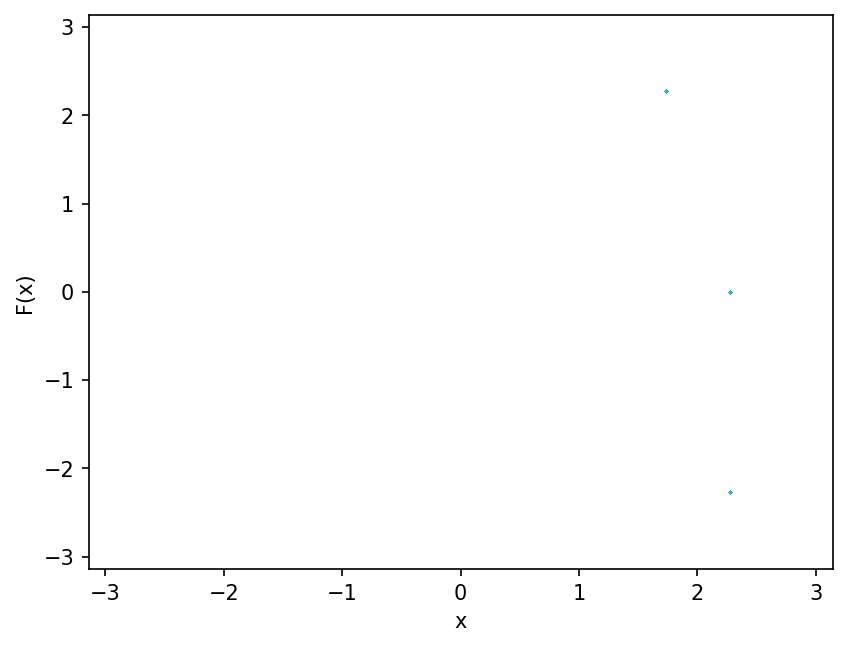

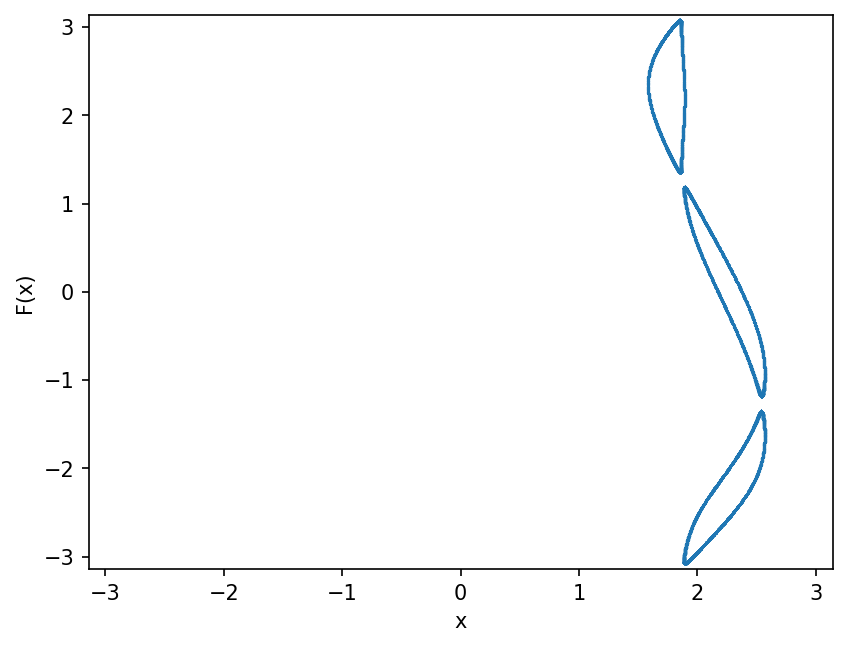

In [140]:
x0, y0 = 2.1, 0

# Using fsolve to find the fixed point
x, y = opt.newton_krylov(lambda p: norm_F(norm_F(norm_F(p,a), a), a) - p, (x0, y0), f_tol=1e-14)

x = np.mod(x, 2*np.pi)
y = np.mod(y, 2*np.pi)

x = x - 2*np.pi*(x>np.pi)
y = y - 2*np.pi*(y>np.pi)

x_t, y_t = norm_F(norm_F(norm_F((x,y), a), a), a)

print(f"Fixed point: ({x}, {y})")
print(f"Testing if it is a fixed point: {x_t-x} and {y_t-y}")

start, end = x, x
plot_NP_magnify_simulation(70, N, a, start, end, magnify=False)


start, end = x-.1, x+.1
N = 10000
plot_NP_magnify_simulation(1, N, a, start, end, magnify=False)



Fixed point: (1.901797439828015, -4.529709940470639e-14)
Testing if it is a fixed point: 1.7763568394002505e-15 and 8.881784197001252e-16


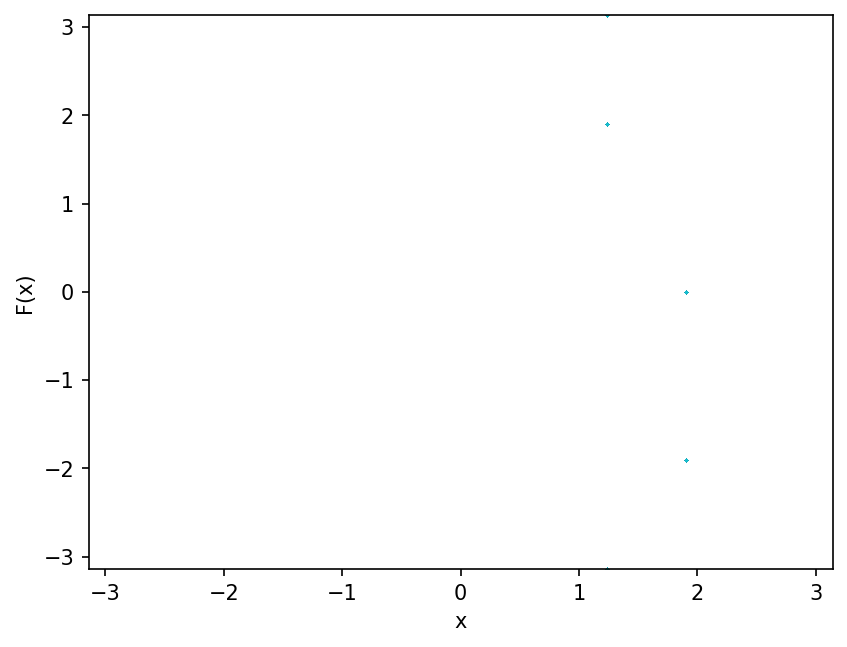

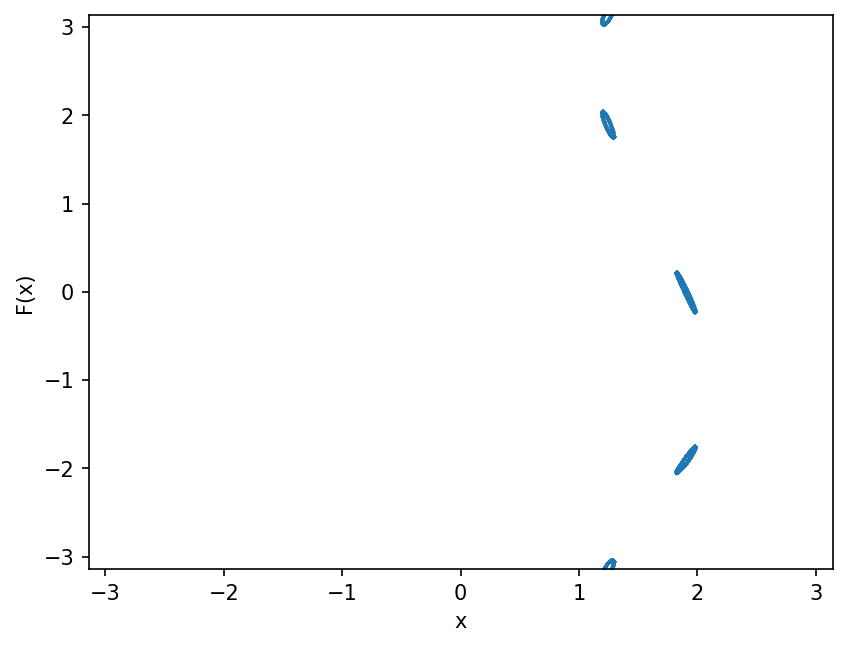

In [141]:
x0, y0 = 1.9, 0


x, y = opt.newton_krylov(lambda p: norm_F(norm_F(norm_F(norm_F(p,a), a), a), a) - p, (x0, y0), f_tol=1e-14)

x = np.mod(x, 2*np.pi)
y = np.mod(y, 2*np.pi)
x = x - 2*np.pi*(x>np.pi)
y = y - 2*np.pi*(y>np.pi)

x_t, y_t = norm_F(norm_F(norm_F(norm_F((x,y), a), a), a), a)

print(f"Fixed point: ({x}, {y})")
print(f"Testing if it is a fixed point: {x_t-x} and {y_t-y}")

start, end = x, x
plot_NP_magnify_simulation(70, N, a, start, end, magnify=False)


start, end = x-.015, x+.015
N = 10000
plot_NP_magnify_simulation(1, N, a, start, end, magnify=False)

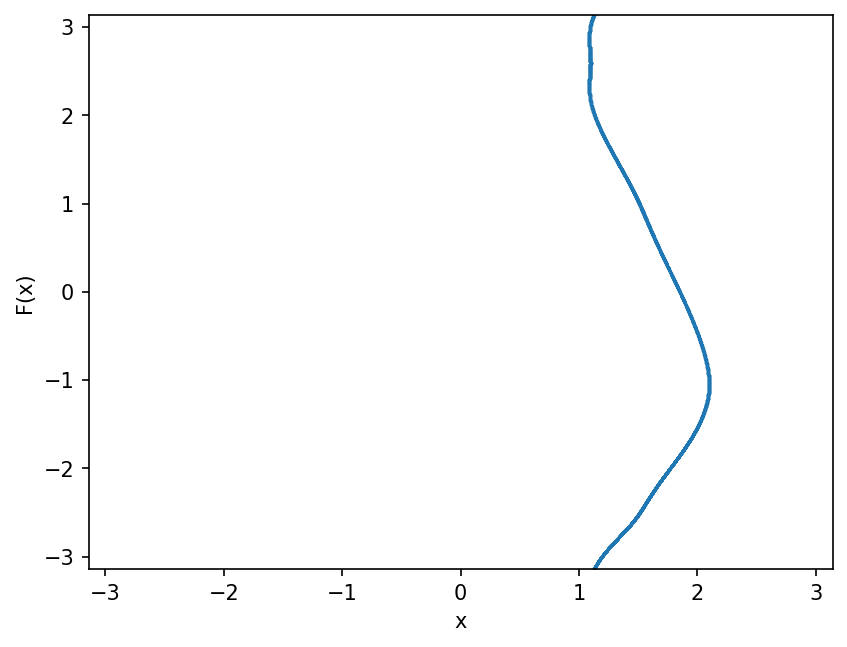

In [142]:
start, end = 1.85, 1.85
plot_NP_magnify_simulation(1, N, a, start, end, magnify=False)

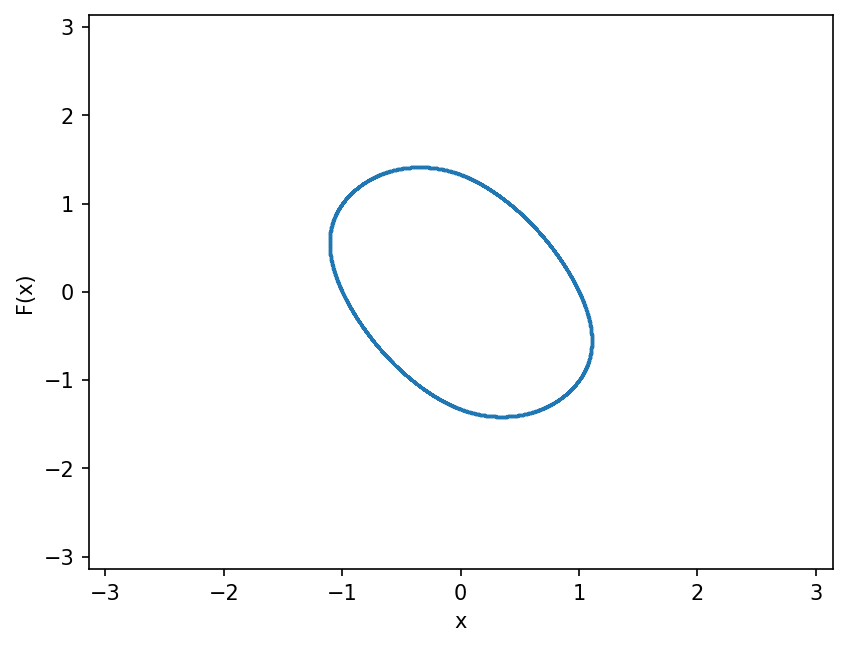

In [143]:
start, end = 1,1
plot_NP_magnify_simulation(1, N, a, start, end, magnify=False)

Animation size has reached 21343201 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


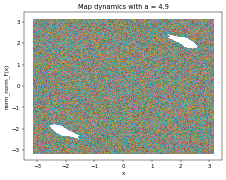

In [144]:
# Create an animation for F, that varies a between -pi and pi
# For each value of a, plot the map for 500 iterations
# Use the animation function from matplotlib

from matplotlib.animation import FuncAnimation
from IPython.display import HTML

fig, ax = plt.subplots()

frame_NO = 100
NP = 50

def update(i):
    ax.clear()
    a = -5 + 10*i/frame_NO
    x, y = NP_simulation(NP, N, a)
    for i in range(NP):
        plt.plot(x[i*N:(i+1)*N], y[i*N:(i+1)*N], '.', markersize=1)
    plt.xlabel('x')
    plt.ylabel('norm_norm_F(x)')
    plt.gcf().set_dpi(40)
    ax.set_title(f"Map dynamics with a = {a}")

ani = FuncAnimation(fig, update, frames=np.arange(0, frame_NO), interval=frame_NO)
#ani.save('animation.gif', writer='pillow', fps=20)
HTML(ani.to_jshtml())

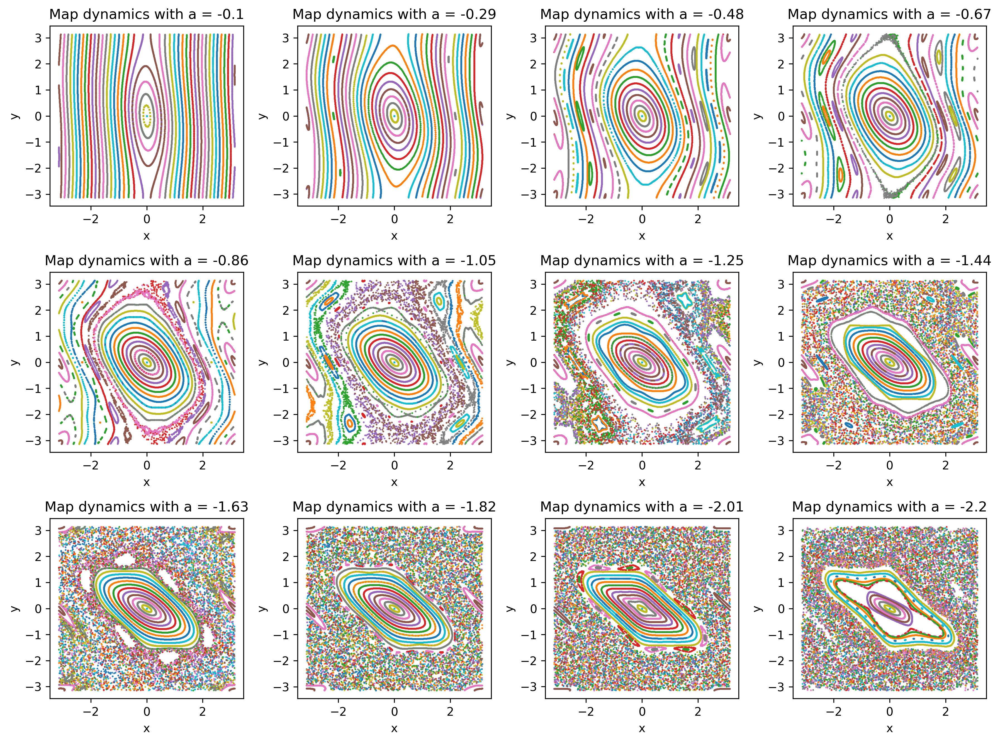

In [ ]:
fig, ((ax1, ax2, ax3, ax4), 
      (ax5, ax6, ax7, ax8), 
      (ax9, ax10, ax11, ax12)) = plt.subplots(3, 4, figsize = (12,9), dpi=300)

figures = [ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9, ax10, ax11, ax12]
j = 0
N= 500

for x in figures:
    x.set_xlabel('x')
    x.set_ylabel('y')
    a = -0.1 - 2.1*j/(len(figures)-1)
    x.set_title(f"Map dynamics with a = {round(a, 2)}")

    x_data, y_data = NP_simulation(NP, N, a)
    for i in range(NP):
        x.plot(x_data[i*N:(i+1)*N], y_data[i*N:(i+1)*N], '.', markersize=1)
    j+=1


fig.tight_layout()
plt.show()